<a href="https://colab.research.google.com/github/Kochurovskyi/Deep_Neural_Network_Projects/blob/main/yolov5_wheat.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Wheat detection model (YOLOv5)

G-drive folder initialization

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


import some required libs

In [2]:
import os
import cv2
from google.colab.patches import cv2_imshow

set default working libruary

In [3]:
os.chdir("/content/drive/My Drive/ML/yolov5")
!ls

data	    LICENSE	 requirements.txt  tutorial.ipynb  wheat_ds_val
detect.py   models	 runs		   utils	   yolov5_wheat
Dockerfile  __pycache__  test.py	   weights
hubconf.py  README.md	 train.py	   wheat_ds_tr


Download YOLOv5 model from the GitHub Repository

In [4]:
'''
!git clone https://github.com/ultralytics/yolov5  # clone repo
!pip install -qr yolov5/requirements.txt  # install dependencies (ignore errors)
%cd yolov5

import torch
from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))
'''

"\n!git clone https://github.com/ultralytics/yolov5  # clone repo\n!pip install -qr yolov5/requirements.txt  # install dependencies (ignore errors)\n%cd yolov5\n\nimport torch\nfrom IPython.display import Image, clear_output  # to display images\nfrom utils.google_utils import gdrive_download  # to download models/datasets\n\nclear_output()\nprint('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))\n"

Installation required libruaries

In [5]:
#pip install -r requirements.txt
#pip install --ignore-installed PyYAML

**data.yaml** file modification:
- train: ./wheat_ds_tr/images/train
- val: ./wheat_ds_tr/images/valid

In [6]:
%cat ./wheat_ds_tr/data.yaml

# Download command:  python -c "from yolov5.utils.google_utils import gdrive_download; gdrive_download('1n_oKgR81BJtqk75b00eAjdv03qVCQn2f','coco128.zip')"
# Train command: python train.py --data ./data/coco128.yaml
# Dataset should be placed next to yolov5 folder:
#   /parent_folder
#     /coco128
#     /yolov5


# train and val datasets (image directory or *.txt file with image paths)
train: ./wheat_ds_tr/images/train
val: ./wheat_ds_tr/images/valid
#/content/drive/My Drive/ML/yolov5/wheat_ds_tr/images/train
#/content/drive/My Drive/ML/yolov5/wheat_ds_tr/images/valid

# number of classes
nc: 1

# class names
names: ['wheat']

**custom_yolov5m.yaml** file modification:

nc: **1**  # number of classes

In [7]:
%cat ./wheat_ds_tr/custom_yolov5m.yaml

# parameters
nc: 1  # number of classes
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1

Model run.

Options:
- train.py - script, going to be run
- --img 1024 - image size
- --batch 4 - batch size (consider imege size im Mb against avalable GPU Memory size
- --epochs 20 - experemtally
- --data ./wheat_ds_tr/data.yaml 
- --cfg ./wheat_ds_tr/custom_yolov5m.yaml 
- --weights ./wheat_ds_tr/yolov5m.pt 
- --name yolov5s_results  - output



In [ ]:
%%time
!python train.py --img 1024 --batch 4 --epochs 20 --data ./wheat_ds_tr/data.yaml --cfg ./wheat_ds_tr/custom_yolov5m.yaml --weights ./wheat_ds_tr/yolov5m.pt --name yolov5s_results

Using CUDA device0 _CudaDeviceProperties(name='Tesla K80', total_memory=11441MB)

Namespace(adam=False, batch_size=4, bucket='', cache_images=True, cfg='./wheat_ds_tr/custom_yolov5m.yaml', data='./wheat_ds_tr/data.yaml', device='', epochs=20, evolve=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[1024, 1024], local_rank=-1, log_imgs=10, logdir='runs/train', multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, rect=False, resume=False, single_cls=False, sync_bn=False, total_batch_size=4, weights='./wheat_ds_tr/yolov5m.pt', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/train", view at http://localhost:6006/
2020-11-10 10:42:39.774482: I tensorflow/stream_executor/platform/default/dso_loader.cc:48] Successfully opened dynamic library libcudart.so.10.1
Install Weights & Biases for experiment logging via 'pip install wandb' (recommended)
Hyperparameters {'lr0': 0.01, 'lrf': 0.2, 'momentum':

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

GROUND TRUTH TRAINING DATA:


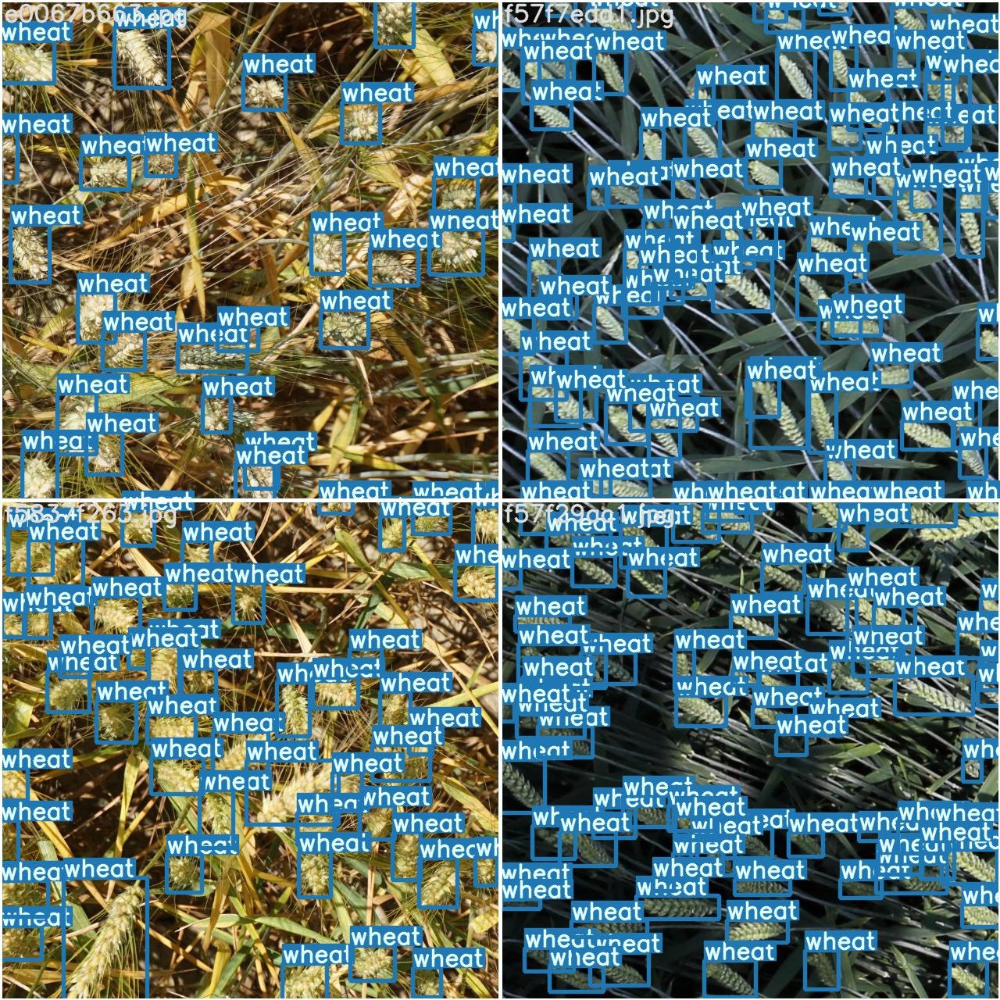

In [ ]:
print("GROUND TRUTH TRAINING DATA:")
path = '/content/drive/My Drive/ML/yolov5/runs/train/exp18_yolov5s_results/test_batch0_gt.jpg'
cv2_imshow(cv2.imread(path))

GROUND TRUTH TRAINING DATA:


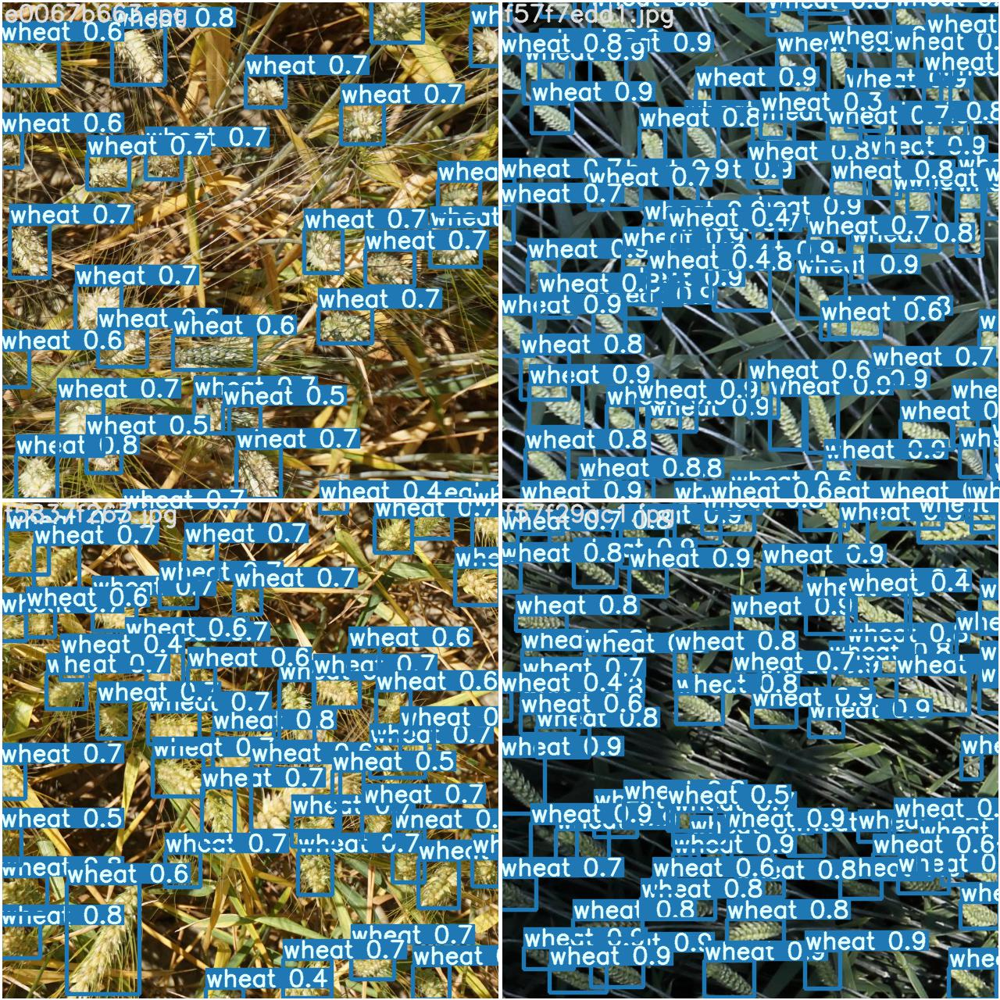

In [ ]:
print("GROUND TRUTH TRAINING DATA:")
path = '/content/drive/My Drive/ML/yolov5/runs/train/exp18_yolov5s_results/test_batch0_pred.jpg'
cv2_imshow(cv2.imread(path))


GROUND TRUTH TRAINING DATA:


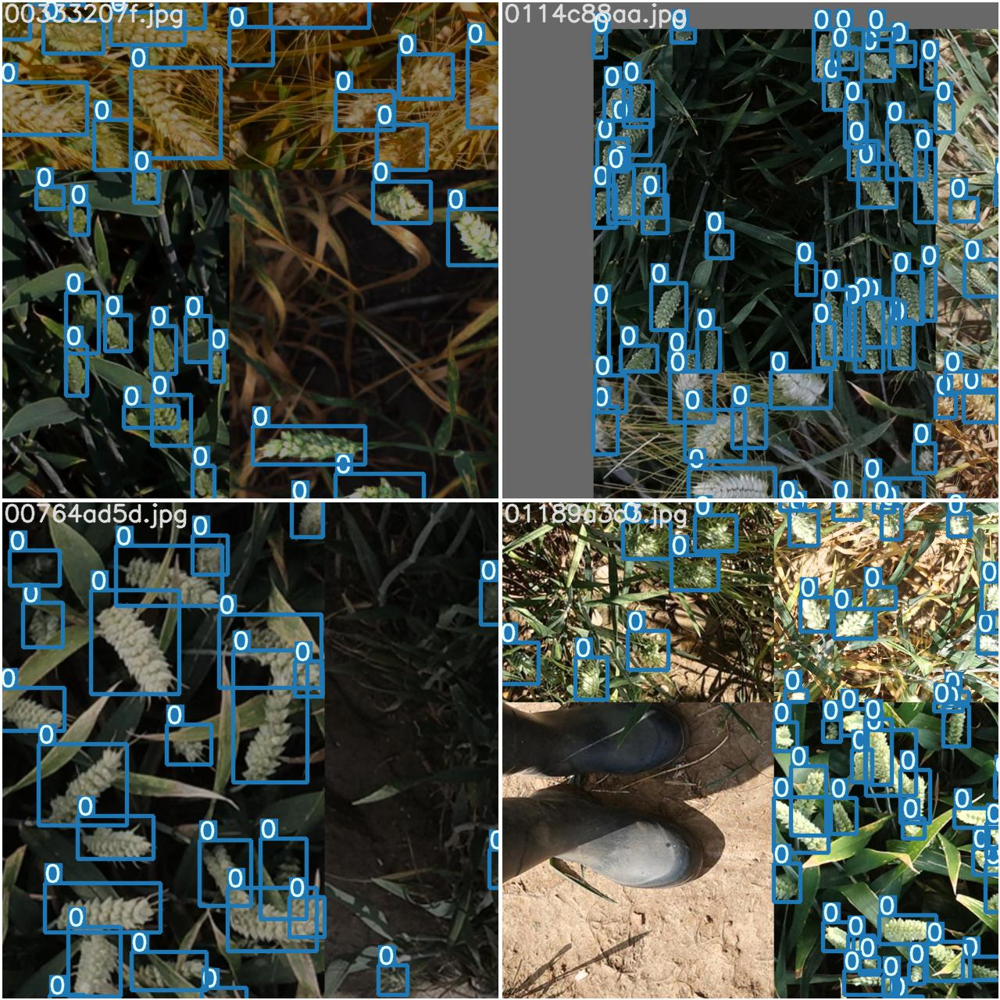

In [ ]:
print("GROUND TRUTH TRAINING DATA:")
path = '/content/drive/My Drive/ML/yolov5/runs/train/exp18_yolov5s_results/train_batch0.jpg'
cv2_imshow(cv2.imread(path))

GROUND TRUTH TRAINING DATA:


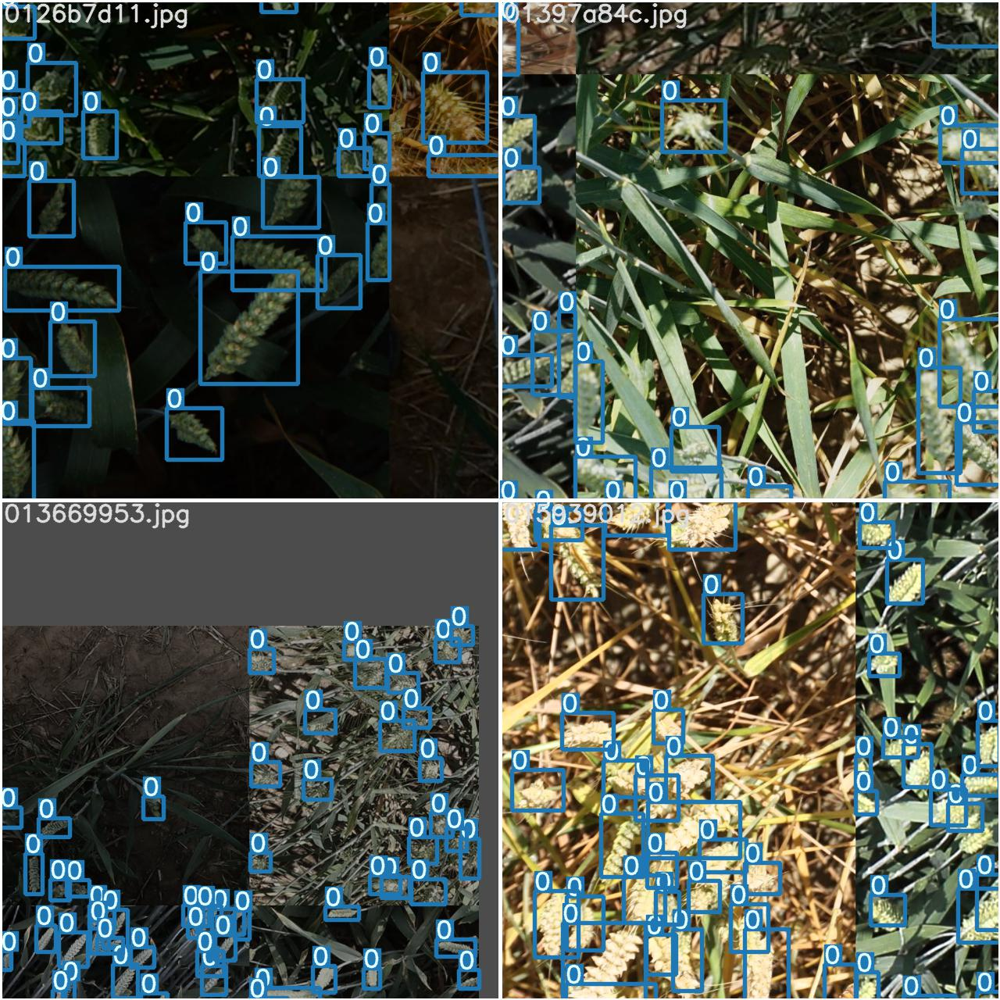

In [ ]:
print("GROUND TRUTH TRAINING DATA:")
path = '/content/drive/My Drive/ML/yolov5/runs/train/exp18_yolov5s_results/train_batch1.jpg'
cv2_imshow(cv2.imread(path))

GROUND TRUTH TRAINING DATA:


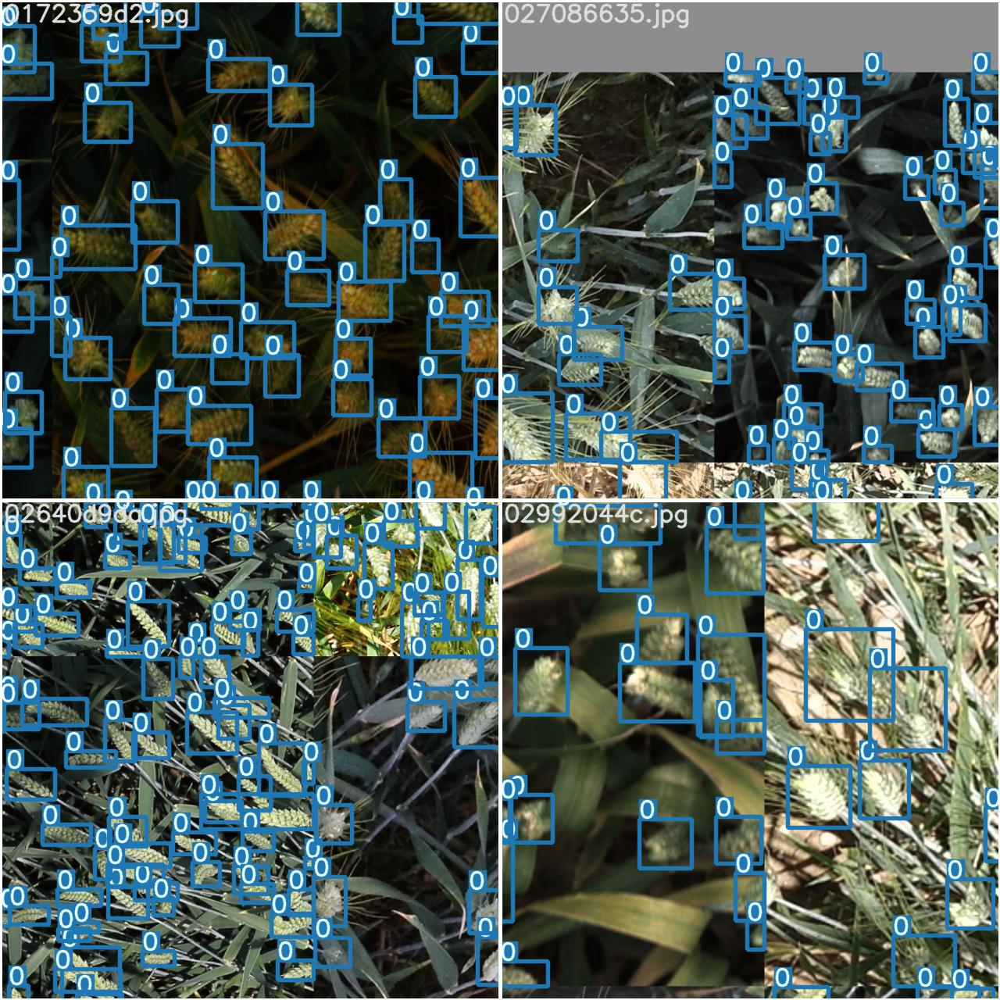

In [ ]:
print("GROUND TRUTH TRAINING DATA:")
path = '/content/drive/My Drive/ML/yolov5/runs/train/exp18_yolov5s_results/train_batch2.jpg'
cv2_imshow(cv2.imread(path))

In [ ]:
os.chdir("/content/drive/My Drive/ML/yolov5")
!ls

data	    LICENSE	 requirements.txt  tutorial.ipynb  wheat_ds_val
detect.py   models	 runs		   utils	   yolov5_wheat
Dockerfile  __pycache__  test.py	   weights
hubconf.py  README.md	 train.py	   wheat_ds_tr


In [ ]:
%%time
!python detect.py --weights ./runs/train/exp18_yolov5s_results/weights/best.pt --img 1024 --conf 0.65 --source ./wheat_ds_val/images --save-txt

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.65, device='', img_size=1024, iou_thres=0.45, name='', save_conf=False, save_dir='runs/detect', save_txt=True, source='./wheat_ds_val/images', update=False, view_img=False, weights=['./runs/train/exp18_yolov5s_results/weights/best.pt'])
Using CUDA device0 _CudaDeviceProperties(name='Tesla K80', total_memory=11441MB)

Fusing layers... 
Model Summary: 188 layers, 2.14686e+07 parameters, 0 gradients
image 1/1000 /content/drive/My Drive/ML/yolov5/wheat_ds_val/images/005b0d8bb.jpg: 1024x1024 19 wheats, Done. (0.179s)
image 2/1000 /content/drive/My Drive/ML/yolov5/wheat_ds_val/images/006a994f7.jpg: 1024x1024 19 wheats, Done. (0.161s)
image 3/1000 /content/drive/My Drive/ML/yolov5/wheat_ds_val/images/00b5c6764.jpg: 1024x1024 Done. (0.140s)
image 4/1000 /content/drive/My Drive/ML/yolov5/wheat_ds_val/images/00b5fefed.jpg: 1024x1024 15 wheats, Done. (0.133s)
image 5/1000 /content/drive/My Drive/ML/yolov5/wheat_ds_val/images/